<a href="https://colab.research.google.com/github/Priyanka-code-sys/bus-delay-airbnb-DMML1-Priyanka/blob/main/bus_delay.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [2]:
pip install sklearn

In [3]:
pip install --upgrade category_encoders

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import category_encoders as ce
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [5]:
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

In [6]:
# Reading data
data = pd.read_csv('/content/drive/MyDrive/Bus_Breakdown_and_Delays.csv')

In [7]:
data.shape

(147972, 21)

In [8]:
data.head()

,School_Year,Busbreakdown_ID,Run_Type,Bus_No,Route_Number,Reason,Schools_Serviced,Occurred_On,Created_On,Boro,Bus_Company_Name,How_Long_Delayed,Number_Of_Students_On_The_Bus,Has_Contractor_Notified_Schools,Has_Contractor_Notified_Parents,Have_You_Alerted_OPT,Informed_On,Incident_Number,Last_Updated_On,Breakdown_or_Running_Late,School_Age_or_PreK
0,2015-2016,1224901,Pre-K/EI,811,1,Other,C353,10/26/2015 08:30:00 AM,10/26/2015 08:40:00 AM,Bronx,"G.V.C., LTD.",10MINUTES,5,Yes,Yes,No,10/26/2015 08:40:00 AM,NaN,10/26/2015 08:40:39 AM,Running Late,Pre-K
1,2015-2016,1225098,Pre-K/EI,9302,1,Heavy Traffic,C814,10/27/2015 07:10:00 AM,10/27/2015 07:11:00 AM,Bronx,"G.V.C., LTD.",25 MINUTES,3,Yes,Yes,No,10/27/2015 07:11:00 AM,NaN,10/27/2015 07:11:22 AM,Running Late,Pre-K
2,2015-2016,1215800,Pre-K/EI,358,2,Heavy Traffic,C195,09/18/2015 07:36:00 AM,09/18/2015 07:38:00 AM,Bronx,"G.V.C., LTD.",15 MINUTES,12,Yes,Yes,Yes,09/18/2015 07:38:00 AM,NaN,09/18/2015 07:38:44 AM,Running Late,Pre-K
3,2015-2016,1215511,Pre-K/EI,331,2,Other,C178,09/17/2015 08:08:00 AM,09/17/2015 08:12:00 AM,Bronx,"G.V.C., LTD.",10 minutes,11,Yes,Yes,Yes,09/17/2015 08:12:00 AM,NaN,09/17/2015 08:12:08 AM,Running Late,Pre-K
4,2015-2016,1215828,Pre-K/EI,332,2,Other,S176,09/18/2015 07:39:00 AM,09/18/2015 07:45:00 AM,Bronx,"G.V.C., LTD.",10MINUTES,12,Yes,Yes,No,09/18/2015 07:45:00 AM,NaN,09/18/2015 07:56:40 AM,Running Late,Pre-K


In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147972 entries, 0 to 147971
Data columns (total 21 columns):
 #   Column                           Non-Null Count   Dtype 
---  ------                           --------------   ----- 
 0   School_Year                      147972 non-null  object
 1   Busbreakdown_ID                  147972 non-null  int64 
 2   Run_Type                         147970 non-null  object
 3   Bus_No                           147972 non-null  object
 4   Route_Number                     147972 non-null  object
 5   Reason                           147972 non-null  object
 6   Schools_Serviced                 147972 non-null  object
 7   Occurred_On                      147972 non-null  object
 8   Created_On                       147972 non-null  object
 9   Boro                             141654 non-null  object
 10  Bus_Company_Name                 147972 non-null  object
 11  How_Long_Delayed                 126342 non-null  object
 12  Number_Of_Studen

# Exploratory Data Analysis

### Missing Values Analysis

In [10]:
# Missing values %
missing_values = data.isna().sum()
missing_values= missing_values/data.shape[0] *100
missing_values

School_Year                         0.000000
Busbreakdown_ID                     0.000000
Run_Type                            0.001352
Bus_No                              0.000000
Route_Number                        0.000000
Reason                              0.000000
Schools_Serviced                    0.000000
Occurred_On                         0.000000
Created_On                          0.000000
Boro                                4.269727
Bus_Company_Name                    0.000000
How_Long_Delayed                   14.617630
Number_Of_Students_On_The_Bus       0.000000
Has_Contractor_Notified_Schools     0.000000
Has_Contractor_Notified_Parents     0.000000
Have_You_Alerted_OPT                0.000000
Informed_On                         0.000000
Incident_Number                    96.193875
Last_Updated_On                     0.000000
Breakdown_or_Running_Late           0.000000
School_Age_or_PreK                  0.000000
dtype: float64

In [11]:
# plotting missing values %
px.bar(missing_values,title="Missing Percentage",color = missing_values.index)

In [12]:
# Data distribution of run type
px.pie(data,names="Run_Type")

In [13]:
df = data.groupby(['School_Year', 'Breakdown_or_Running_Late']).size()
df = pd.DataFrame(df)
df = df.reset_index()
px.bar(x=df.School_Year,y=df[0],color=df.Breakdown_or_Running_Late,barmode="group",title="Delay analyis per year")

In [14]:
breakdown = pd.DataFrame(data.groupby(["Breakdown_or_Running_Late"]))[1][0]
running_late = pd.DataFrame(data.groupby(["Breakdown_or_Running_Late"]))[1][1]

In [15]:
breakdown.Route_Number.value_counts()[:10]
px.bar(breakdown.Route_Number.value_counts()[:10],color=breakdown.Route_Number.value_counts()[:10].values,title="Routes with maximum breakdown")

In [16]:
running_late.Route_Number.value_counts()[:10]
px.bar(running_late.Route_Number.value_counts()[:10],color=running_late.Route_Number.value_counts()[:10].values,title="Routes having maximum bus delays")

In [17]:
px.bar(data[data["Reason"] == "Heavy Traffic"].Route_Number.value_counts()[:20],title="Routes with high traffic")

In [18]:
not_bus_issue = ["Heavy Traffic","Weather Conditions","Delayed by School","Late return from Field Trip"]
# Getting data that is not present in not_bus_issue
df = data.query("Reason not in @not_bus_issue")
px.bar(df.Bus_No.value_counts()[0:50],color=df.Bus_No.value_counts()[0:50].values,title="Bus Encountring more mechanical faliures")

In [19]:
df = data.groupby(['School_Year', 'Schools_Serviced']).size()
df = pd.DataFrame(df)
df = df.reset_index()
px.bar(df.School_Year.value_counts(),color=df.School_Year.value_counts().values,title="Schools serviced Per Year")

In [20]:
not_bus_issue = ["Heavy Traffic","Weather Conditions","Delayed by School","Late return from Field Trip"]
df = data.query("Reason not in @not_bus_issue")
px.bar(df.Schools_Serviced.value_counts()[:25],color=df.Schools_Serviced.value_counts().values[:25],title="Schools that had poor transortation facility")

In [21]:
# Converting feature to datetime
data.Occurred_On = pd.to_datetime(data.Occurred_On)

In [22]:
# Get month names and plot delays per month
df = data.Occurred_On.dt.month_name().value_counts()
fig = go.Figure(data=go.Scatter(
    x=df.index,
    y=df.values,
    mode='lines+markers',
    marker=dict(size=df.values/500,
                color=df.values)
))
fig.update_layout(
    title="Number of delays per month")

fig.show()

In [23]:
# Get hourly delay
df = data.Occurred_On.dt.hour.value_counts()
px.scatter(df,color=df.values,size=df.values,hover_name=df.index,title="Delayes reported per hour")

In [24]:
# Converting to date time
data.Created_On = pd.to_datetime(data.Created_On)

In [25]:
# Get time gap between occurance and reported delay
data["time_gap"] = (data.Created_On-data.Occurred_On).astype('timedelta64[h]').values

In [26]:
df = data.loc[data['time_gap']!=data['time_gap'].max()]
df = df.loc[df['time_gap']!=df['time_gap'].min()]
px.box(x=df.time_gap.values,title="Time Delay(Minutes) between delay reported and delay creation")

In [27]:
not_bus_issue = ["Heavy Traffic","Weather Conditions","Delayed by School","Late return from Field Trip"]
df = data.query("Reason not in @not_bus_issue")
df = df.Bus_Company_Name.value_counts()
fig = go.Figure(data=go.Scatter(
    x=df.index[:25],
    y=df.values[:25],
    mode='lines+markers',
    marker=dict(size=df.values/100,
                color=df.values)
))
fig.update_layout(
    title="Top 25 companies with maximum mechanical issues")

fig.show()

In [28]:
df = data.groupby(['Boro', 'Breakdown_or_Running_Late']).size()
df = pd.DataFrame(df)
df = df.reset_index()
px.bar(x=df.Boro,y=df[0],color=df.Breakdown_or_Running_Late,barmode="group",title="Delay analysis per city")

In [29]:
px.pie(data,names="Boro",title="Delay chances per city")

In [30]:
import re
# Get delay in miinutes from How_Long_Delayed by applying regex expression
delayed_time = []
for x in data.How_Long_Delayed :
    if x is not np.nan:
        if re.findall(r"^[0-9]+",x):
            delayed_time+= re.findall(r"^[0-9]+",x)
        else:
            delayed_time+=[0]
    else:
        delayed_time+=[np.nan]
data.How_Long_Delayed = delayed_time

In [31]:
# Get distribution of delay 
px.box(data.How_Long_Delayed.dropna().astype(np.int64),title="Average delay")

In [32]:
px.pie(data,names="Has_Contractor_Notified_Parents",title="Has_Contractor_Notified_Parents")

In [33]:
df = data[["Occurred_On","Number_Of_Students_On_The_Bus"]]
df["month"] = data["Occurred_On"].dt.month_name()
# Sum of students per month in the bus
df = df.groupby(["month"]).Number_Of_Students_On_The_Bus.sum()
fig = go.Figure(data=go.Scatter(
    x=df.index,
    y=df.values,
    mode='lines+markers',
    marker=dict(size=df.values/1000,
                color=df.values)
))
fig.update_layout(
    title="Students lives Endangered per month")

fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



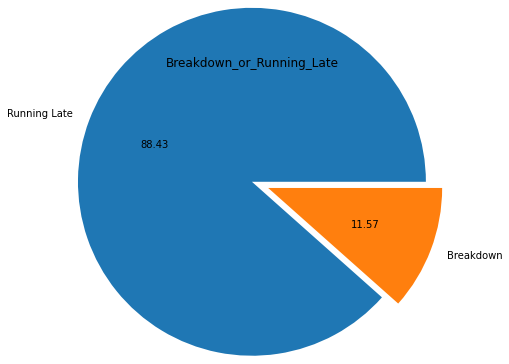

In [34]:
# Distribution of label
plt.title("Breakdown_or_Running_Late")
plt.pie(data.Breakdown_or_Running_Late.value_counts(),explode=[0,0.2],autopct="%.2f",labels=data.Breakdown_or_Running_Late.value_counts().index,radius=2)
plt.show()

# Data Preprocessing

In [35]:
# Extracting features month name and hour of day
data["month"] = data.Occurred_On.dt.month
data["time"] = data.Occurred_On.dt.hour

In [36]:
# Drpping irrelevant features
data.drop(["School_Year","Busbreakdown_ID","Schools_Serviced","Occurred_On","Created_On","Informed_On","Incident_Number","Last_Updated_On"],axis=1,inplace=True)

In [37]:
# Imputing nan values with mean of feature How_Long_Delayed
data.How_Long_Delayed.fillna("mean",inplace=True)

In [38]:
# Drop NULL values
data.dropna(inplace=True)

In [39]:
# Some values are useless so we will remove those values
remove_Run_Type = ["Project Read PM Run","Project Read AM Run","Project Read Field Trip"]
data = data.query("Reason not in @not_bus_issue")

In [40]:
# Label Encoding features
label_enc = LabelEncoder()
data.Has_Contractor_Notified_Schools = label_enc.fit_transform(data.Has_Contractor_Notified_Schools)

label_enc = LabelEncoder()
data.Has_Contractor_Notified_Parents = label_enc.fit_transform(data.Has_Contractor_Notified_Parents)

label_enc = LabelEncoder()
data.Have_You_Alerted_OPT = label_enc.fit_transform(data.Have_You_Alerted_OPT)

label_enc = LabelEncoder()
data.School_Age_or_PreK = label_enc.fit_transform(data.School_Age_or_PreK)

label_enc = LabelEncoder()
data.Breakdown_or_Running_Late = label_enc.fit_transform(data.Breakdown_or_Running_Late)

/usr/local/lib/python3.7/dist-packages/pandas/core/generic.py:5170: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



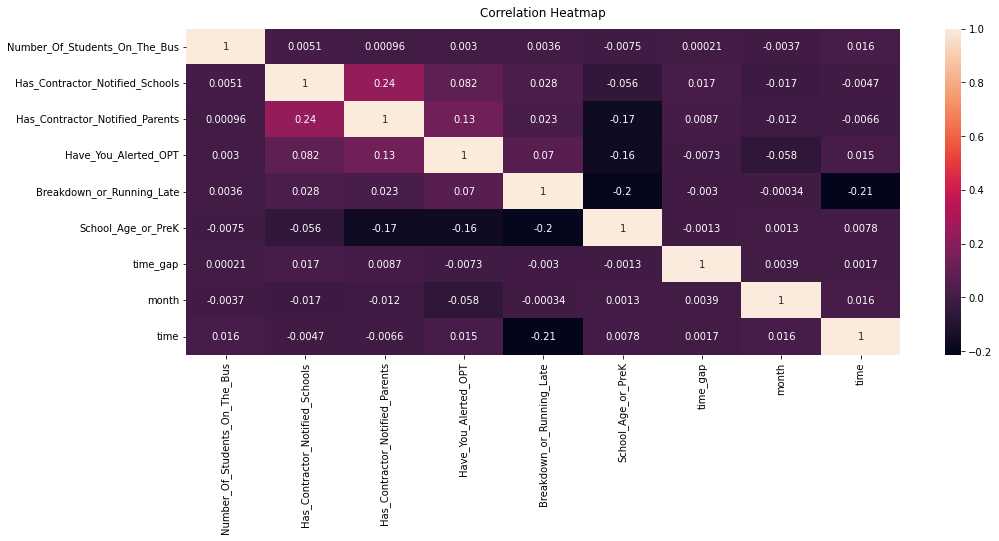

In [41]:
#heat map using Pearson's coefficient
plt.figure(figsize=(16, 6))
sns.heatmap(data.corr(), annot=True)
plt.title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

In [42]:
# Hash Encoding features that have multiple distinct values
hash_enc=ce.HashingEncoder(cols='Bus_No',n_components=10)
data = hash_enc.fit_transform(data)

hash_enc=ce.HashingEncoder(cols='Route_Number',n_components=10)
data = hash_enc.fit_transform(data)

hash_enc=ce.HashingEncoder(cols='Bus_Company_Name',n_components=10)
data = hash_enc.fit_transform(data)

In [43]:
# Getting label
Y = data.Breakdown_or_Running_Late

In [44]:
Y.value_counts()

1    33245
0    16308
Name: Breakdown_or_Running_Late, dtype: int64

In [45]:
px.pie(names=Y.astype(str),title="Labels Before Balancing")

In [46]:
# Getting Feature
X = data.drop("Breakdown_or_Running_Late",axis=1)
X = pd.get_dummies(X)

In [47]:
oversample = SMOTE()
X, Y = oversample.fit_resample(X.values, Y.values)

In [48]:
print("Final Data Shape : ",X.shape)

Final Data Shape :  (66490, 175)


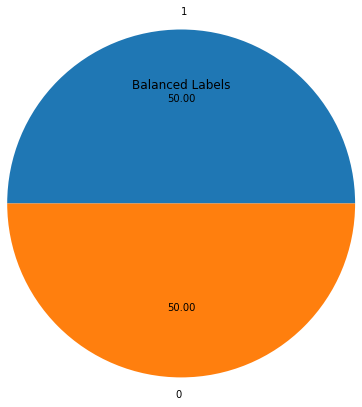

In [49]:
plt.title("Balanced Labels")
plt.pie(pd.Series(Y).value_counts(),autopct="%.2f",labels=data.Breakdown_or_Running_Late.value_counts().index,radius=2)
plt.show()

In [50]:
!pip install catboost

In [51]:
from sklearn.decomposition import PCA
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score,precision_score,recall_score

In [52]:
# Splitting data in ration 70:30
X_train,X_test,Y_train,Y_test = train_test_split(X,Y,test_size=0.3)

In [53]:
print("Train Data : ",X_train.shape)
print("Test Data : ",X_test.shape)

Train Data :  (46543, 175)
Test Data :  (19947, 175)


In [54]:
# Applying PCA to reduce features
pca = PCA(n_components=4)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

In [55]:
print("Train Data : ",X_train.shape)
print("Test Data : ",X_test.shape)

Train Data :  (46543, 4)
Test Data :  (19947, 4)


# Model HyperTuning

In [56]:
index = ["LogisticRegression","DecisionTreeClassifier","RandomForestClassifier","XGBClassifier","CatBoostClassifier"]
results = pd.DataFrame(columns=['Accuracy','Precison','Recall'],index=index)

### LogisticRegression

In [57]:
log_reg = LogisticRegression(n_jobs=-1)
log_param_grid = [{"max_iter":[50,100,200],"tol" : [0.001,0.0001,0.01]}]
model_log = GridSearchCV(log_reg,log_param_grid,cv=10,scoring="accuracy")

In [58]:
model_log.fit(X_train,Y_train)

GridSearchCV(cv=10, estimator=LogisticRegression(n_jobs=-1),
             param_grid=[{'max_iter': [50, 100, 200],
                          'tol': [0.001, 0.0001, 0.01]}],
             scoring='accuracy')

In [59]:
model_log = LogisticRegression(**model_log.best_params_)
model_log.fit(X_train,Y_train)

pred_ = model_log.predict(X_test)

acc = accuracy_score(Y_test,pred_)
prec = precision_score(Y_test,pred_,average="weighted")
rec = recall_score(Y_test,pred_,average="weighted")

print("Accuracy :: ",acc)
print("Precision :: ",prec)
print("Recall :: ",rec)

results.loc["LogisticRegression"] = [acc,prec,rec]

Accuracy ::  0.6079109640547451
Precision ::  0.6286402008359696
Recall ::  0.6079109640547451


### DecisionTreeClassifier

In [60]:
tree_clf = DecisionTreeClassifier()
tree_param_grid = [{"max_depth":[5,10,50,100],"max_leaf_nodes":list(range(2,10,2))}]
model_tree = GridSearchCV(tree_clf,tree_param_grid,cv=10,scoring="accuracy")

In [61]:
model_tree.fit(X_train,Y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(),
             param_grid=[{'max_depth': [5, 10, 50, 100],
                          'max_leaf_nodes': [2, 4, 6, 8]}],
             scoring='accuracy')

In [62]:
tree_clf = DecisionTreeClassifier(**model_tree.best_params_)
tree_clf.fit(X_train,Y_train)

pred_ = tree_clf.predict(X_test)
acc = accuracy_score(Y_test,pred_)
prec = precision_score(Y_test,pred_,average="weighted")
rec = recall_score(Y_test,pred_,average="weighted")

print("Accuracy :: ",acc)
print("Precision :: ",prec)
print("Recall :: ",rec)

results.loc["DecisionTreeClassifier"] = [acc,prec,rec]

Accuracy ::  0.658695543189452
Precision ::  0.666019530695436
Recall ::  0.658695543189452


### RandomForestClassifier

In [63]:
forest_clf = RandomForestClassifier(n_jobs=-1)
forest_param_grid = [{"n_estimators":[50,100,200,250],"max_depth":[5,10,25,50],"max_features":[1,2,3,4]}]
model_forest = GridSearchCV(forest_clf,forest_param_grid,cv=10,scoring="accuracy")

In [ ]:
model_forest.fit(X_train,Y_train)

In [ ]:
model_forest = RandomForestClassifier(**model_forest.best_params_)
model_forest.fit(X_train,Y_train)

pred_ = model_forest.predict(X_test)
acc = accuracy_score(Y_test,pred_)
prec = precision_score(Y_test,pred_,average="weighted")
rec = recall_score(Y_test,pred_,average="weighted")

print("Accuracy :: ",acc)
print("Precision :: ",prec)
print("Recall :: ",rec)

results.loc["RandomForestClassifier"] = [acc,prec,rec]

### XGBoostClassifier

In [ ]:
xgb_clf = XGBClassifier(n_jobs=-1)
xgb_param_grid = [{"learning_rate":[0.1,0.01,0.001],"max_depth":[5,10,25,50]}]
model_xgb = GridSearchCV(xgb_clf,xgb_param_grid,cv=10,scoring="accuracy")

In [ ]:
model_xgb.fit(X_train,Y_train)

In [ ]:
model_xgb = XGBClassifier(**model_xgb.best_params_)
model_xgb.fit(X_train,Y_train)

pred_ = model_xgb.predict(X_test)
acc = accuracy_score(Y_test,pred_)
prec = precision_score(Y_test,pred_,average="weighted")
rec = recall_score(Y_test,pred_,average="weighted")

print("Accuracy :: ",acc)
print("Precision :: ",prec)
print("Recall :: ",rec)

results.loc["XGBClassifier"] = [acc,prec,rec]

### CatBoostClassifier

In [ ]:
cat_clf = CatBoostClassifier()
cat_param_grid = [{"n_estimators":[10,25,50],"learning_rate":[0.1,0.01,0.001]}]
model_cat = GridSearchCV(cat_clf,cat_param_grid,cv=10,scoring="accuracy")

In [ ]:
model_cat.fit(X_train,Y_train)

In [ ]:
model_cat = CatBoostClassifier(**model_cat.best_params_)
model_cat.fit(X_train,Y_train)

pred_ = model_cat.predict(X_test)
acc = accuracy_score(Y_test,pred_)
prec = precision_score(Y_test,pred_,average="weighted")
rec = recall_score(Y_test,pred_,average="weighted")

print("Accuracy :: ",acc)
print("Precision :: ",prec)
print("Recall :: ",rec)

results.loc["CatBoostClassifier"] = [acc,prec,rec]

# Model Comparison

In [ ]:
results = results*100
results

In [ ]:
px.bar(results,y ="Accuracy",x = results.index,color = results.index,title="Accuracy Comparison")

In [ ]:
px.bar(results,y ="Precison",x = results.index,color = results.index,title="Precision Comparison")

In [ ]:
px.bar(results,y ="Recall",x = results.index,color = results.index,title="Recall Comparison")

In [ ]:
# Getting confusion matrix
pred_ = model_forest.predict(X_test)
conf_matrix = confusion_matrix(Y_test,pred_)

In [ ]:
plt.figure(figsize=(10,8))
plt.title("HeatMap of Random Forest")
sns.heatmap(conf_matrix, annot=True,fmt='.10g')
plt.show()

In [ ]:
plt.figure(figsize=(10,8))


# Compute fpr, tpr, thresholds and roc auc
fpr, tpr, thresholds = roc_curve(Y_test, pred_)
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.plot(fpr, tpr, label='ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # random predictions curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate or (1 - Specifity)')
plt.ylabel('True Positive Rate or (Sensitivity)')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")

plt.show()